In [5]:
from IPython.display import display, HTML, Image
display(HTML("<style>.container { width:95% !important; }</style>"))

%load_ext autoreload
%autoreload 2

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import matplotlib.cbook
warnings.simplefilter(action='ignore', category=matplotlib.cbook.MatplotlibDeprecationWarning)

import os
import numpy as np
import pandas as pd
import scanpy as sc
from scipy.sparse import csr_matrix
import scvelo as scv
import matplotlib.pyplot as plt

import sys
sys.path.append("../../lib")


# from deg_utils import DEGonAnnData
# from pathways import genesDicts

# from scanpy.tools._score_genes import score_genes

# from cheatmap import cplot, prepForCplot
# from pathways import genesDicts
# from vplot import wrapVplotRatio, wrapVplotScore, wrapVplotGene
from stpalette import palette_WM4007_rna, palette_WM4237_rna
from plots import plotSpatialAll
from plots import plotPhiHeatmap
from utils import computFullGridVelocity, getGridPhi, getGridVelocityForSourceSink, getFiOfEmb

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [7]:
def plotFiForAd(ad):
    X_grid_full, V_grid_full, X_emb = computFullGridVelocity(ad, emb='umap')
    gridPhi = getGridPhi(X_grid_full, V_grid_full, R=3)
    plotPhiHeatmap(gridPhi, X_grid_full, emb='umap', aspect=1);
    
    params = dict(basis='X_umap', density=1, arrow_size=4, arrow_length=1, color=identity, palette=palette_rna, size=45, alpha=0.75, legend_loc='none')

    X_source, V_source = getGridVelocityForSourceSink(X_grid_full, V_grid_full, gridPhi, isSource=True)
    scv.pl.velocity_embedding_grid(ad, X_grid=X_source, V_grid=V_source, title='Source', **params)
    
    X_sink, V_sink = getGridVelocityForSourceSink(X_grid_full, V_grid_full, gridPhi, isSource=False)
    scv.pl.velocity_embedding_grid(ad, X_grid=X_sink, V_grid=V_sink, title='Sink', **params)

    Fi_emb = getFiOfEmb(X_grid_full, gridPhi, X_emb)
    ad.obs['Fi_umap'] = Fi_emb
    sc.pl.umap(ad, color='Fi_umap', cmap='bwr')
    sc.pl.violin(ad, keys='Fi_umap', groupby='cluster')
    return

# scv.pl.velocity_embedding(ad_all_temp_T, basis='X_umap', arrow_size=2, arrow_length=2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
# scv.pl.velocity_embedding_grid(ad_all_temp_T, basis='X_umap', density=1, arrow_size=2, arrow_length=2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
# ad_temp = ad_all_temp_T[ad_all_temp_T.obs['sample']=='WM4237_T2_S1_ST'].copy()
# sc.pl.spatial(ad_temp, color=['cluster', 'Fi_umap'], cmap='bwr', spot_size=450)
# # sc.pl.violin(ad_all_temp_T, keys='Fi_umap', groupby='cluster')

In [8]:
model = 'WM4237'
palette_rna = palette_WM4007_rna if model=='WM4007' else palette_WM4237_rna

In [9]:
initialLibrarySizes = {'WM4237_T0_S1_ST': 20508.0,
                    'WM4237_T0_S2_ST': 23357.0,
                    'WM4237_T1_S1_ST': 12028.0,
                    'WM4237_T1_S2_ST': 5046.0,
                    'WM4237_T2_S1_ST': 7235.0,
                    'WM4237_T2_S2_ST': 7340.0,
                    'WM4237_T3_S1_ST': 9253.0,
                    'WM4237_T3_S2_ST': 14952.0,
                    'WM4237_T4_S1_ST': 14214.0,
                    'WM4237_T4_S2_ST': 11604.0,
                    'WM4237_TC_S1_ST': 12571.0,
                    'WM4237_TC_S2_ST': 19977.0,
                    'WM4237_TE_S1_ST': 27421.0,
                    'WM4237_TE_S2_ST': 32372.0,
                    'WM4237_TE_S3_ST': 30370.0,
                    'WM4237_TE_S4_ST': 39643.0}

In [15]:
dataPath = '../../data/'
preprocessedStDataPath = 'd:/from HPCC 11 28 2022/results_NF1-nod-t2t-k35/%s/' % model
preprocessedVelDataPath = 'd:/from HPCC 11 28 2022/results_NF3-nod-t2t-k35/%s/' % model

ids = sorted(np.loadtxt(dataPath + 'ids_%s_ST.txt' % model, dtype=str))
print(ids, '\n')

ids = pd.Series(ids)
cond1 = ids.str.contains('E_S')
cond2 = ids.str.contains('0_S')
cond3 = ids.str.contains('C_S')
#ids = ids[cond1].values.tolist() + ids[cond2].values.tolist() + ids[cond3].values.tolist() + ids[~cond1 & ~cond2 & ~cond3].values.tolist()
ids = ids[cond2].values.tolist() + ids[cond3].values.tolist() + ids[~cond1 & ~cond2 & ~cond3].values.tolist()
# ids = ids.values.tolist()
print(ids)

['WM4237_T0_S1_ST', 'WM4237_T0_S2_ST', 'WM4237_T1_S1_ST', 'WM4237_T1_S2_ST', 'WM4237_T2_S1_ST', 'WM4237_T2_S2_ST', 'WM4237_T3_S1_ST', 'WM4237_T3_S2_ST', 'WM4237_T4_S1_ST', 'WM4237_T4_S2_ST', 'WM4237_TC_S1_ST', 'WM4237_TC_S2_ST', 'WM4237_TE_S1_ST', 'WM4237_TE_S2_ST', 'WM4237_TE_S3_ST', 'WM4237_TE_S4_ST'] 

['WM4237_T0_S1_ST', 'WM4237_T0_S2_ST', 'WM4237_TC_S1_ST', 'WM4237_TC_S2_ST', 'WM4237_T1_S1_ST', 'WM4237_T1_S2_ST', 'WM4237_T2_S1_ST', 'WM4237_T2_S2_ST', 'WM4237_T3_S1_ST', 'WM4237_T3_S2_ST', 'WM4237_T4_S1_ST', 'WM4237_T4_S2_ST']


In [16]:
ad_all = sc.read(dataPath + 'ad_all_human_clustered_st_%s.h5ad' % model)
ad_all.shape

(18406, 18720)

In [17]:
ads = {id: ad_all[ad_all.obs['sample']==id, :] for id in ids}

images = {id: sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id).uns['spatial'] for id in ids}

for sample in ids[:]:
    ads[sample] = ad_all[ad_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample]

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
 

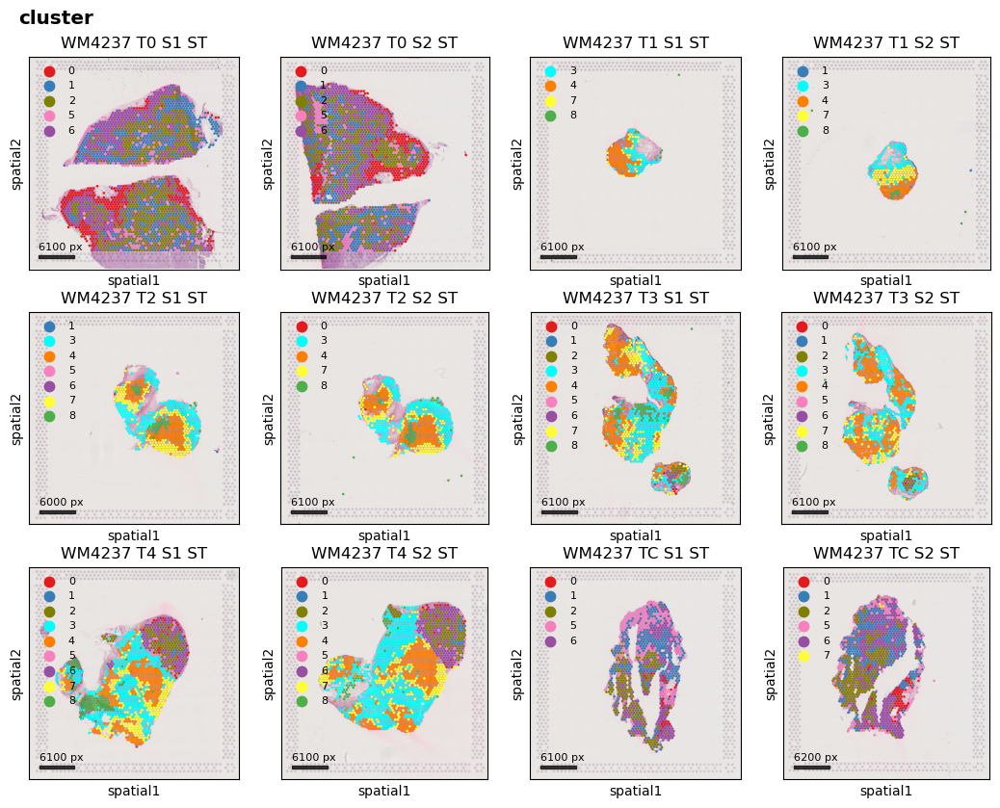

In [18]:
plotSpatialAll(ads, identity='cluster', palette=palette_rna, f=0.65)

Loaded WM4237_T0_S1_ST
Loaded WM4237_T0_S2_ST
Loaded WM4237_TC_S1_ST
Loaded WM4237_TC_S2_ST
Loaded WM4237_T1_S1_ST
Loaded WM4237_T1_S2_ST
Loaded WM4237_T2_S1_ST
Loaded WM4237_T2_S2_ST
Loaded WM4237_T3_S1_ST
Loaded WM4237_T3_S2_ST
Loaded WM4237_T4_S1_ST
Loaded WM4237_T4_S2_ST


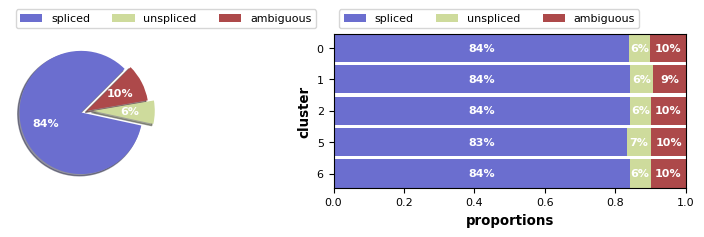

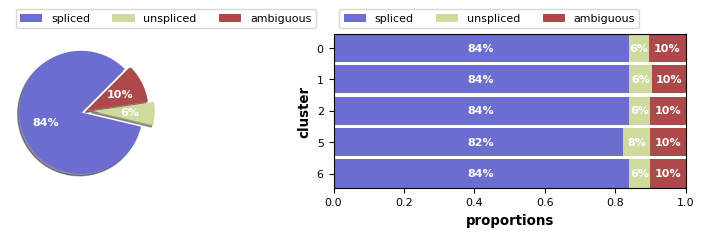

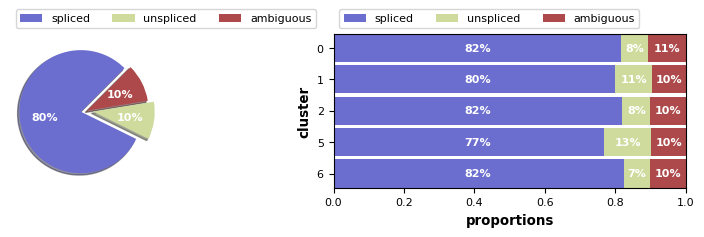

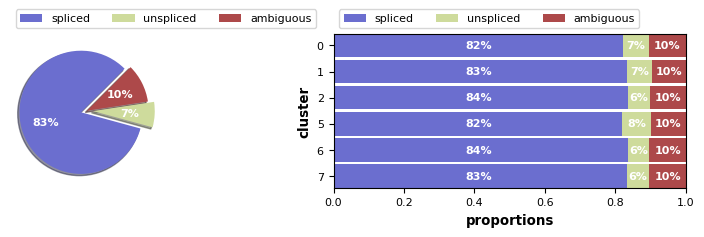

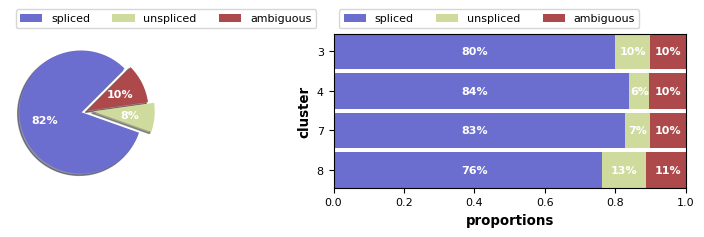

...

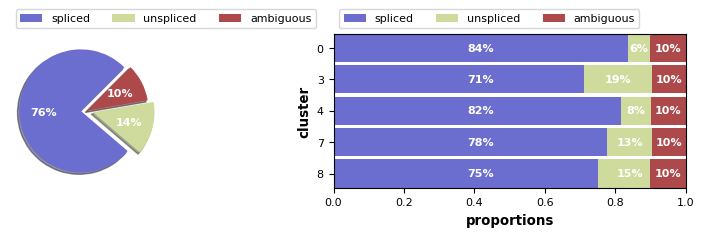

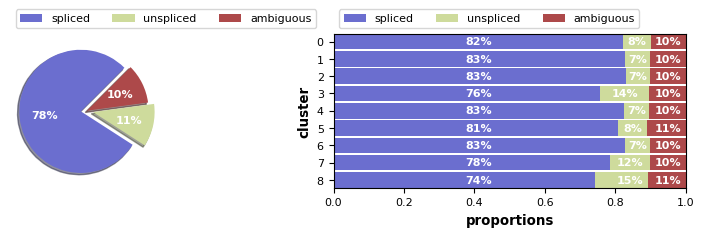

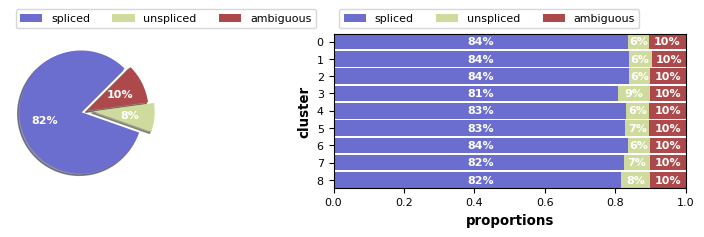

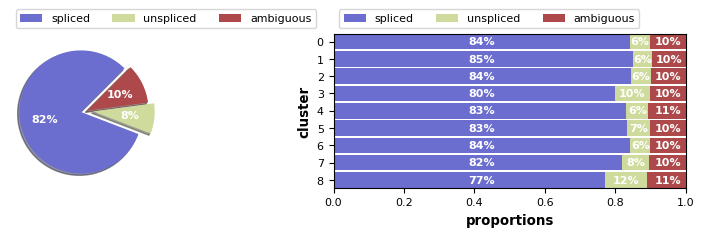

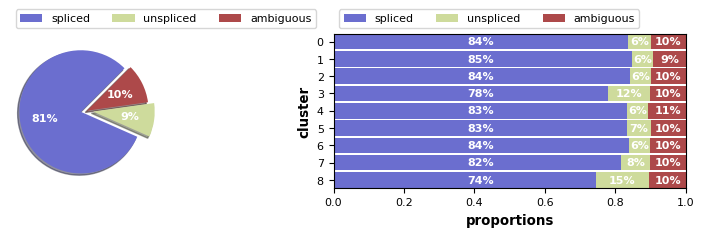

Normalized WM4237_T0_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T0_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_TC_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_TC_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T1_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T1_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T2_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T2_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T3_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T3_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T4_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4237_T4_S2_ST
Normalized count data: X, spliced, unspliced.


In [19]:
def loadAddLayersVelocytoData(ids=[], ads=[], dataPath='', identity='', tfactor=20000., layers=['spliced', 'unspliced', 'ambiguous'], initialLibrarySizes=None):

    '''Modifies ads in place'''
    
    als = dict()
    for id in ids:
        if not id in als.keys():
            try:
                al_temp = sc.read_loom(f'{dataPath}/{id}/human/velocyto.loom')
                al_temp.var_names_make_unique()
                als.update({id: al_temp})
                print('Loaded %s' % id)
            except Exception as exception:
                print(id, exception)
                
    for id in ids:
        if id in als.keys():
            ads[id].obs['velocyto_id'] = 'sample:' + ads[id].obs.index.str.split('-', expand=True).get_level_values(0) + 'x'
            try:
                for layer in layers:
                    ads[id].layers[layer] = csr_matrix(pd.DataFrame(index=als[id].obs.index, 
                                                                    data=als[id].layers[layer].todense(), 
                                                                    columns=als[id].var.index).reindex(ads[id].obs['velocyto_id'].values).T.reindex(ads[id].var.index).fillna(0).astype(int).T)
                    ads[id].layers[layer] = ads[id].layers[layer]*initialLibrarySizes[id] / tfactor
                    
                scv.pl.proportions(ads[id], groupby=identity, layers=layers)
            except Exception as exception:
                print(id, exception)   
                
    for id in ids:
        print('Normalized %s' % id)
        ad_temp = ads[id].copy()
        scv.pp.normalize_per_cell(ad_temp, enforce=True)
        for layer in layers:
            ads[id].layers[layer] = ad_temp.layers[layer].copy()
        
    return

loadAddLayersVelocytoData(ids=ids[:], ads=ads, dataPath=preprocessedVelDataPath, identity='cluster', initialLibrarySizes=initialLibrarySizes)

In [20]:
def getLayersAll():   
    df_var = pd.concat([ads[id].var for id in ids])
    ad_all_temp = sc.concat({id:ads[id] for id in ids[:]}, label='sample', join='outer')
    ad_all_temp.var = df_var.loc[~df_var.index.duplicated()].reindex(ad_all_temp.var.index)
    ad_all_temp = ad_all_temp[:, ad_all_temp.var['is_human_gene']]
    return ad_all_temp.layers['spliced'], ad_all_temp.layers['unspliced'], ad_all_temp.obs.index, ad_all_temp.var.index

layer_spliced, layer_unspliced, spots, genes = getLayersAll()

In [21]:
ad_all_temp = ad_all[spots, genes].copy()
ad_all_temp.layers['spliced'] = layer_spliced
ad_all_temp.layers['unspliced'] = layer_unspliced
del layer_spliced, layer_unspliced

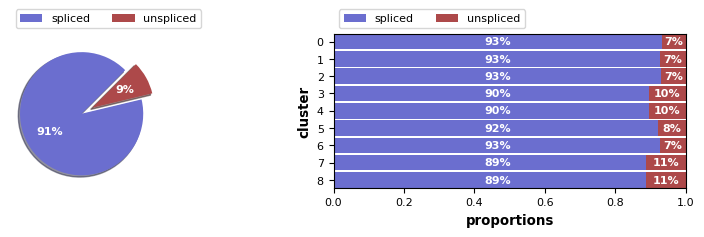

In [22]:
identity = 'cluster'
ad_all_temp.obs[identity] = ad_all_temp.obs[identity].astype('category')
scv.pl.proportions(ad_all_temp, groupby=identity, layers=['spliced', 'unspliced'])

# Calculate velocity for the entire model

In [24]:
scv.tl.velocity_graph(ad_all_temp, basis='umap')

computing velocities
    finished (0:00:53) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/14083 [00:00<?, ?cells/s]

    finished (0:00:42) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:05) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


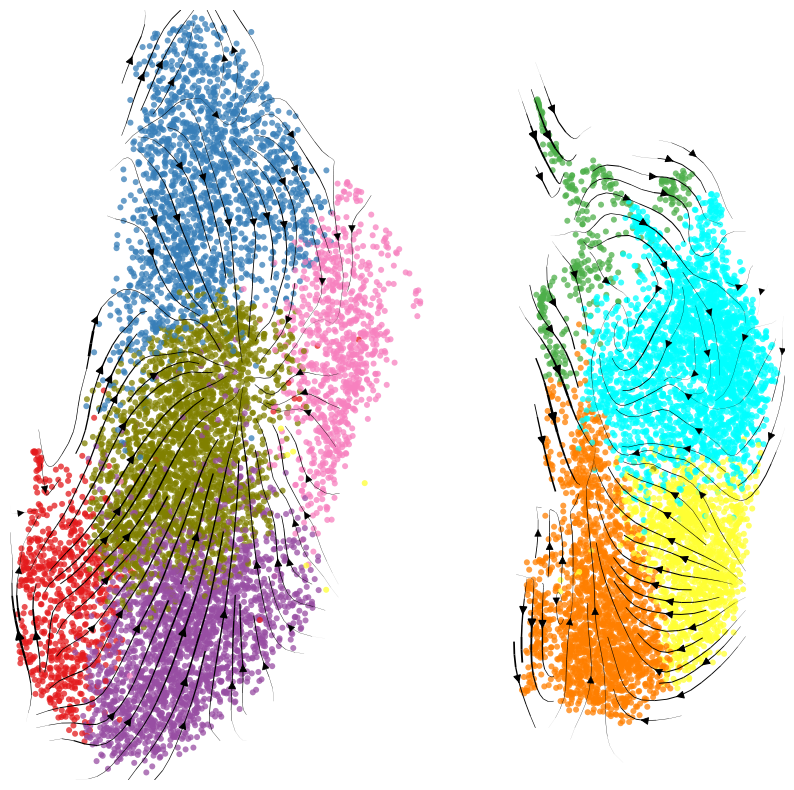

In [25]:
plt.rcParams["figure.figsize"] = (10,10)
scv.pl.velocity_embedding_stream(ad_all_temp, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')

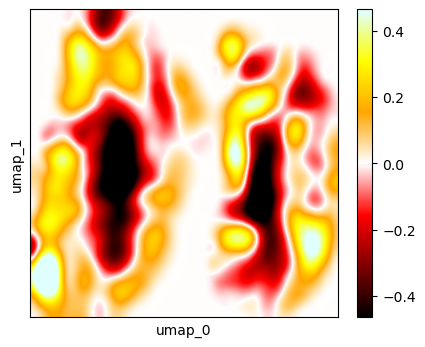

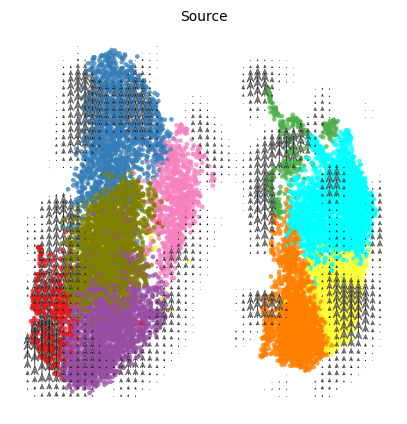

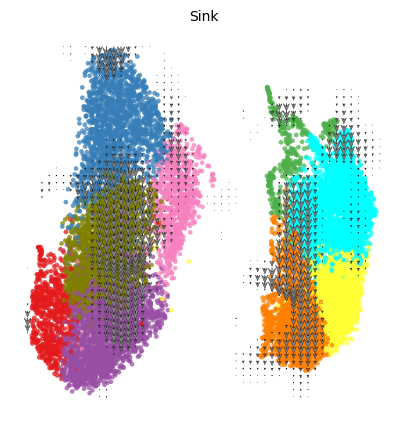

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


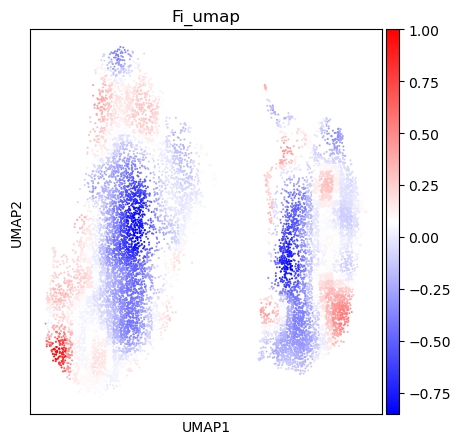

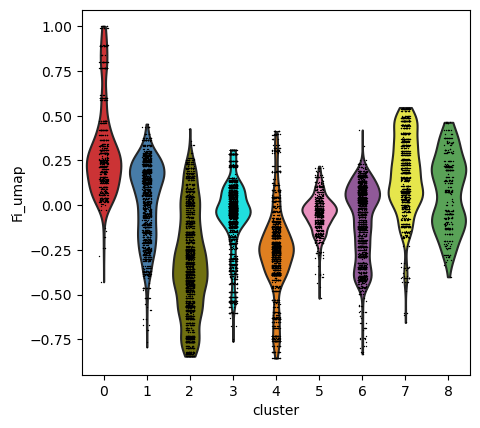

In [26]:
plt.rcParams["figure.figsize"] = (5,5)
plotFiForAd(ad_all_temp)

# Calculate velocity on UMAP per timepoint

computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/2169 [00:00<?, ?cells/s]

    finished (0:00:18) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


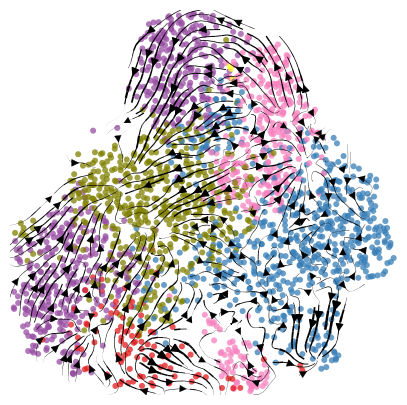

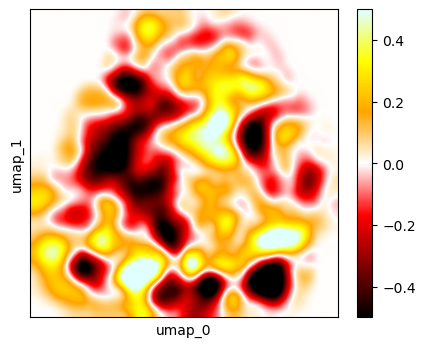

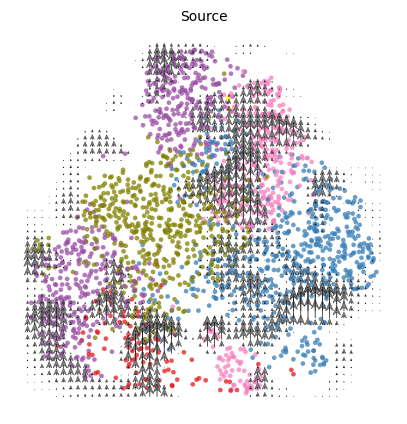

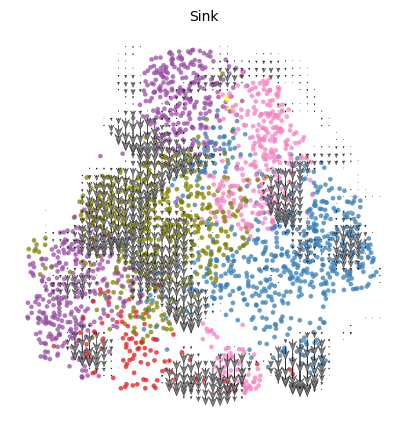

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


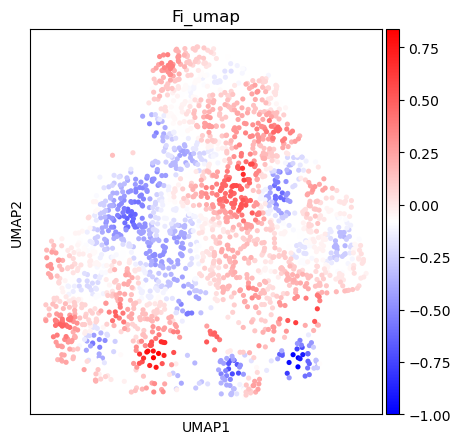

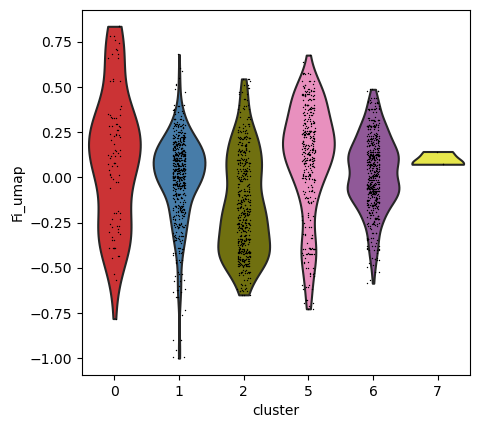

In [15]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['TC']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:08) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/4960 [00:00<?, ?cells/s]

    finished (0:00:08) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


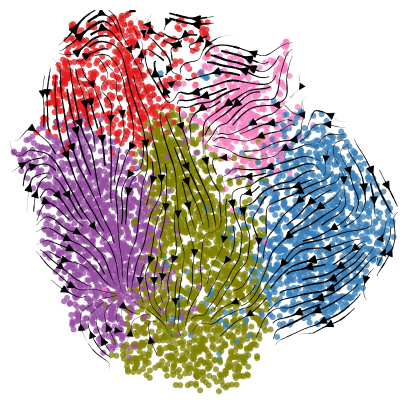

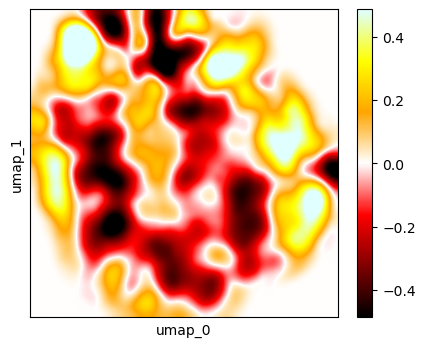

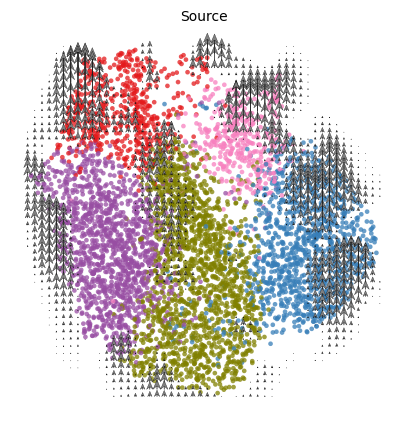

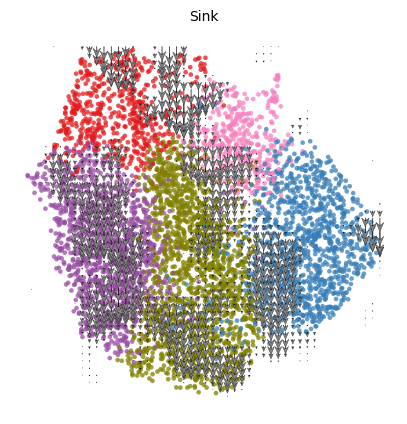

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


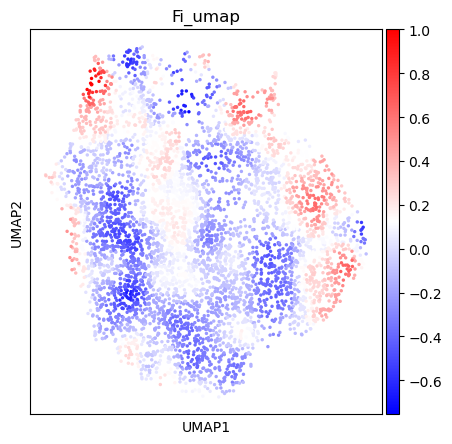

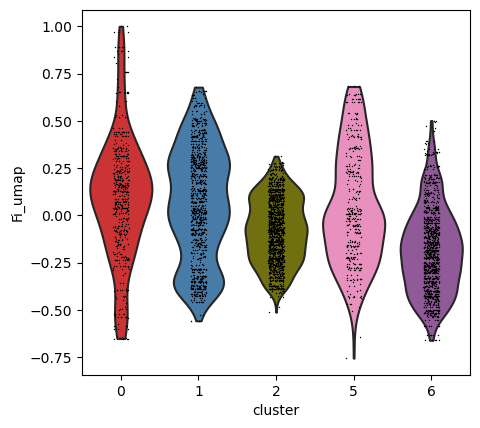

In [16]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T0']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/1315 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


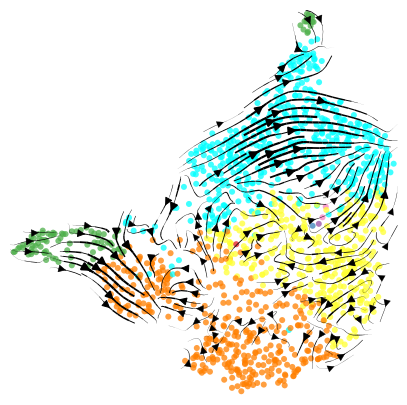

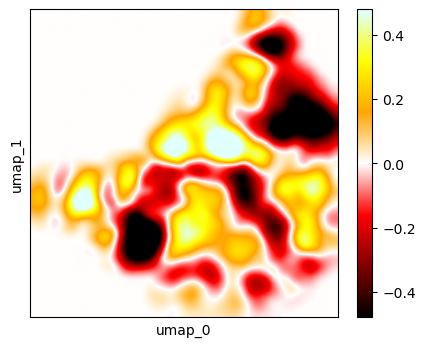

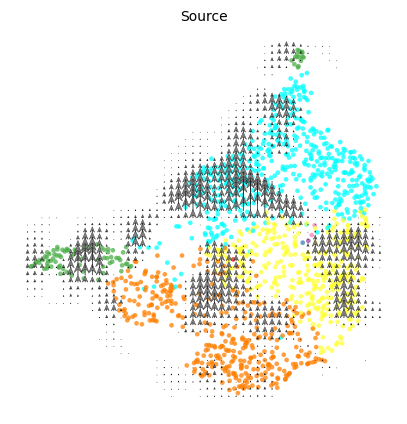

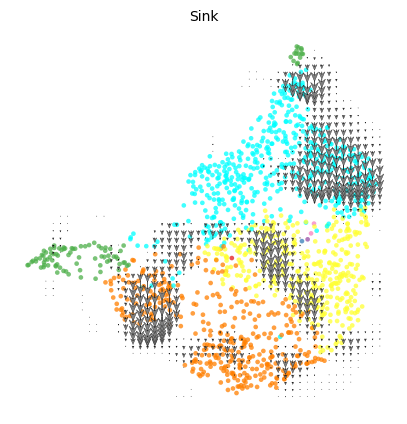

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


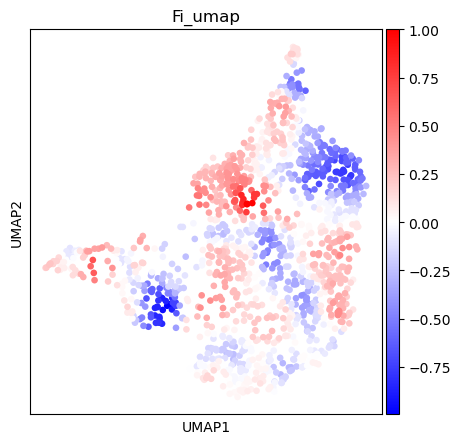

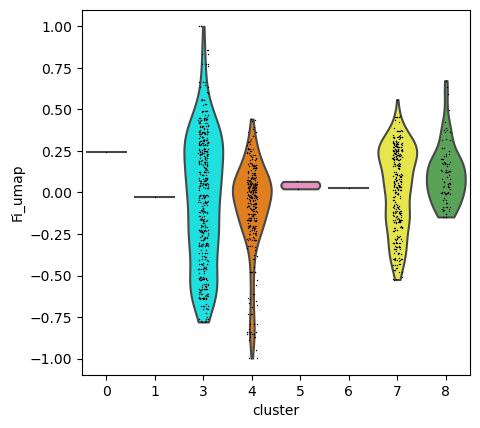

In [17]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T2']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/1906 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


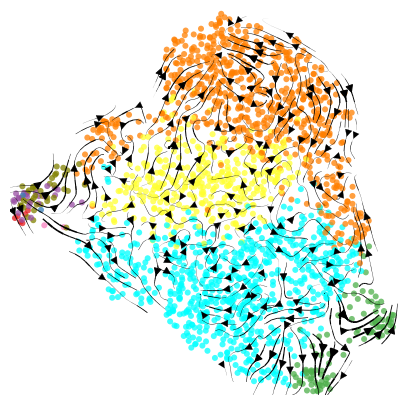

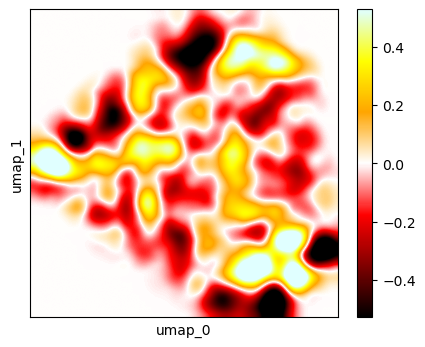

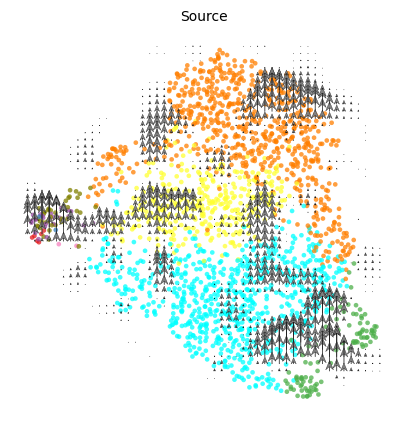

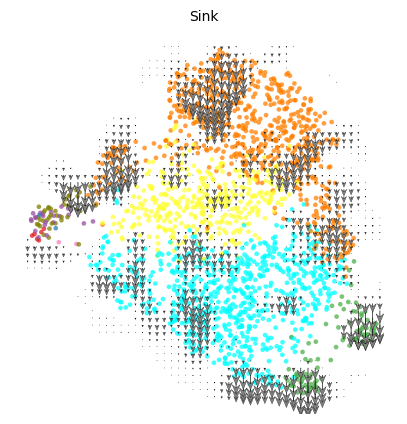

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


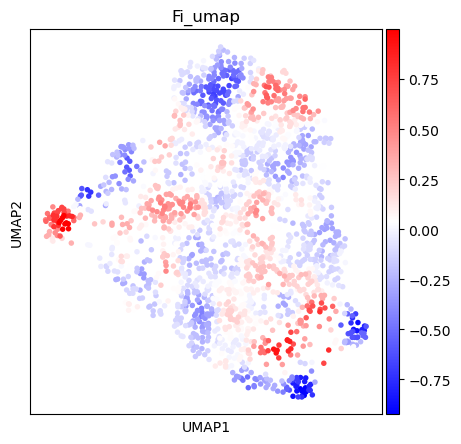

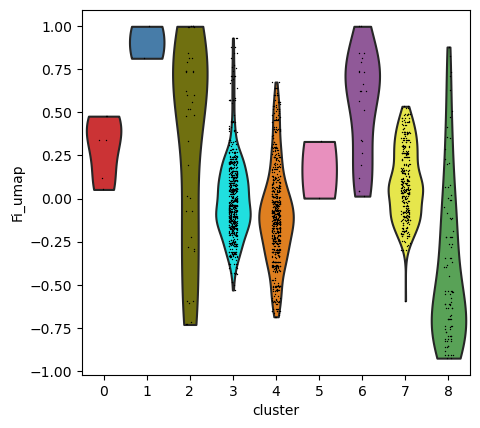

In [18]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T3']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:05) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/3253 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


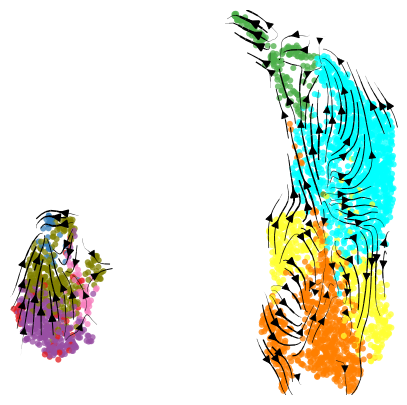

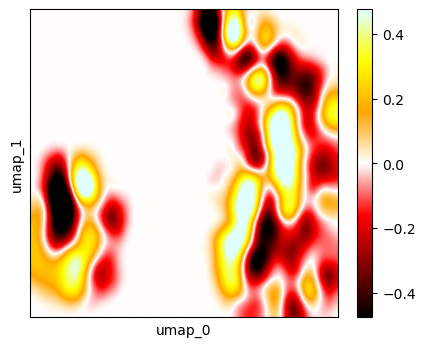

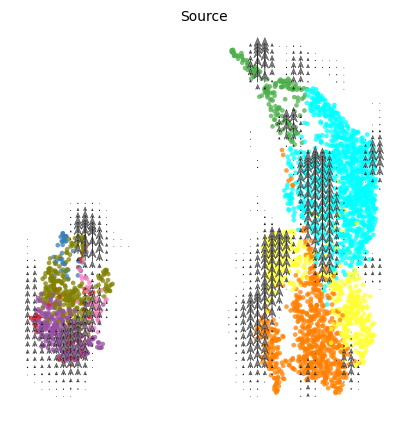

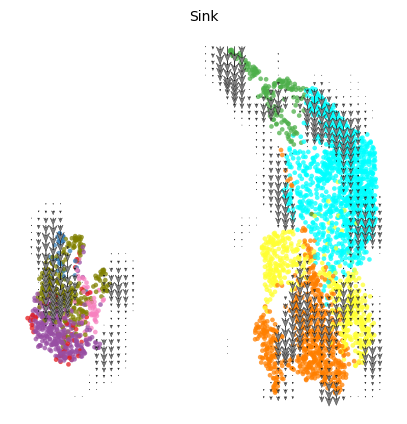

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


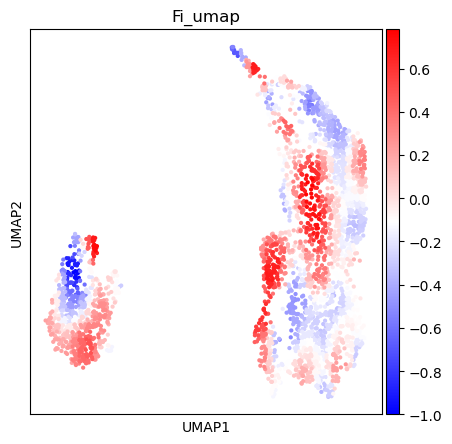

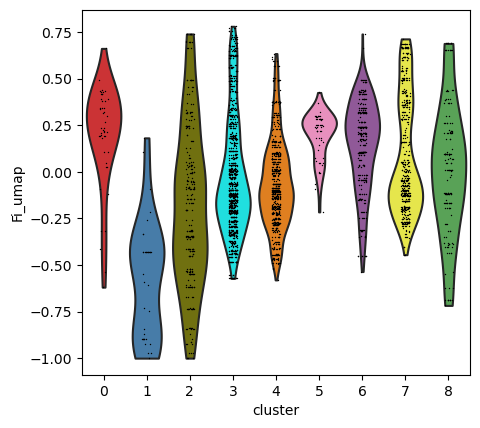

In [19]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T4']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

# Calculate velocity on the spatial layout

In [13]:
for id in ids[:]:
    print('\n\n\n', id)
    ad = ads[id]
    identity = 'cluster'
    scv.pp.moments(ad)
    scv.tl.velocity(ad, mode='stochastic')
    scv.pp.neighbors(ad)
    scv.tl.umap(ad)
    scv.tl.velocity_graph(ad, basis='umap')
    scv.tl.velocity_graph(ad, basis='spatial')
    ad.obsm['X_spatial'] = np.array([ad.obsm['spatial'].T[0], -ad.obsm['spatial'].T[1]]).T.astype(float)




 WM4237_T0_S1_ST
computing neighbors
    finished (0:00:18) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:06) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/2580 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/2580 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T0_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:05) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/2380 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/2380 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_TC_S1_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/976 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/976 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_TC_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1193 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1193 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T1_S1_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/216 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/216 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T1_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/264 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/264 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T2_S1_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/647 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/647 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T2_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/668 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/668 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T3_S1_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1011 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1011 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T3_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/895 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/895 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T4_S1_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:04) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1438 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1438 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4237_T4_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:05) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1815 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1815 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)


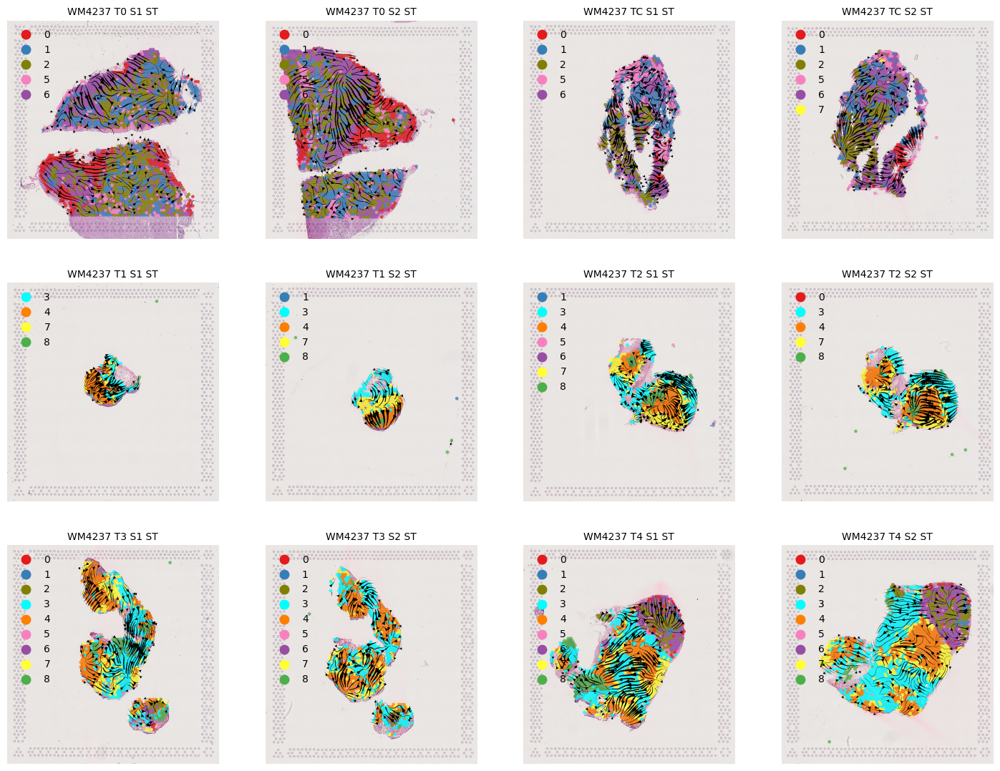

In [14]:
f = 1.0
ncols = 4
nrows = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(f*4.5*ncols, f*4.5*nrows))
for isample, sample in enumerate(ids):
    ax = axs[int((isample - isample%ncols)/nrows), isample%ncols]
    identity = 'cluster'
    ad = ads[sample]
    
    scv.pl.velocity_embedding_stream(ad, basis='X_spatial', arrow_size=0.6, color=identity, palette=palette_rna, 
                                     title=sample, size=45, alpha=0.75, show=False, ax=ax, legend_loc='none') # 250 for 12x12
    
    (xmin, xmax), (ymin, ymax) = ax.get_xlim(), ax.get_ylim()
    sf = ads[sample].uns['spatial']['library_id']['scalefactors']['tissue_lowres_scalef']
    image = ad.uns['spatial']['library_id']['images']['lowres'].copy()
    ax.imshow(image, interpolation='none', extent=[0, image.shape[1]/sf, -20/sf-image.shape[1]/sf, 0], zorder=-1)
    
    ax.legend(frameon=False, loc='upper left', fontsize=10, markerscale=1.5)

plt.subplots_adjust(wspace=0.15, hspace=0.2)
# fig.savefig('spatial rna velocity.png', dpi=450)

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


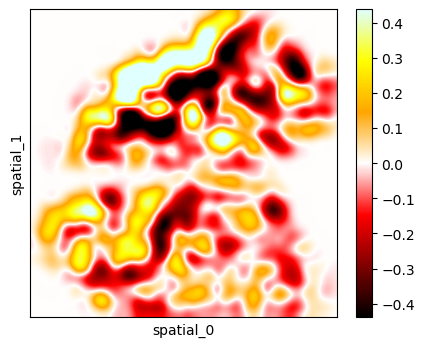

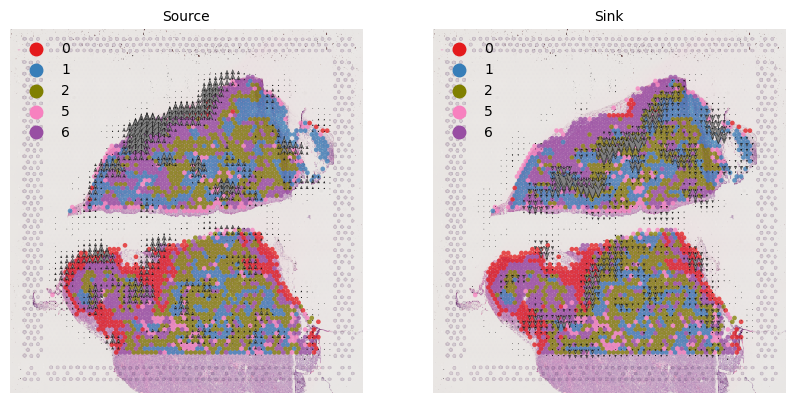

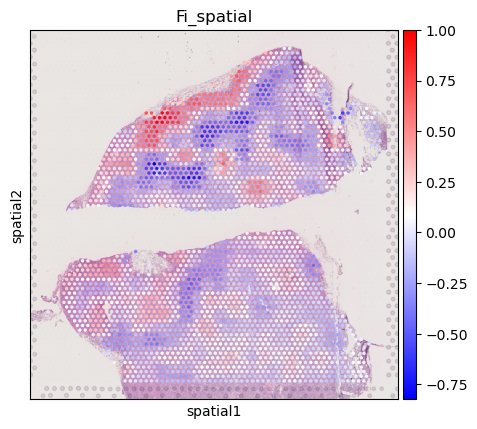

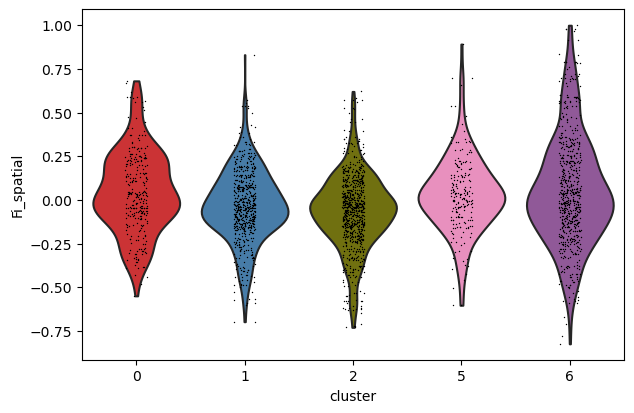

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


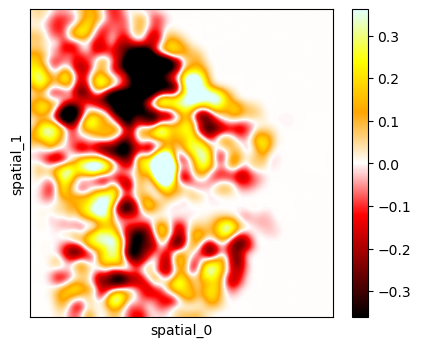

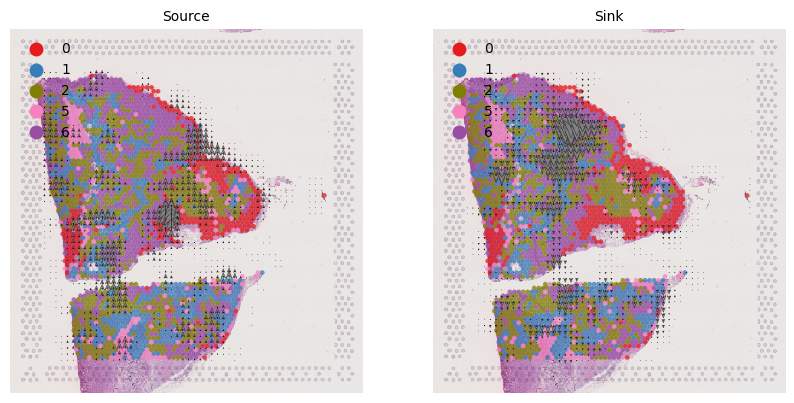

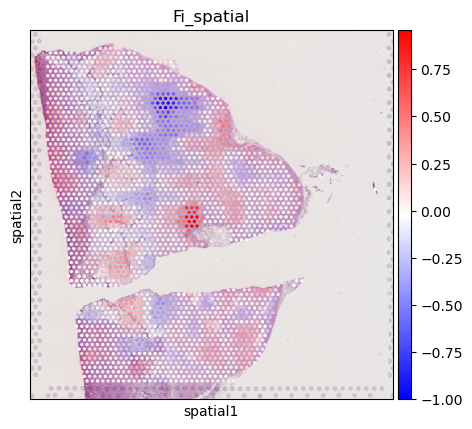

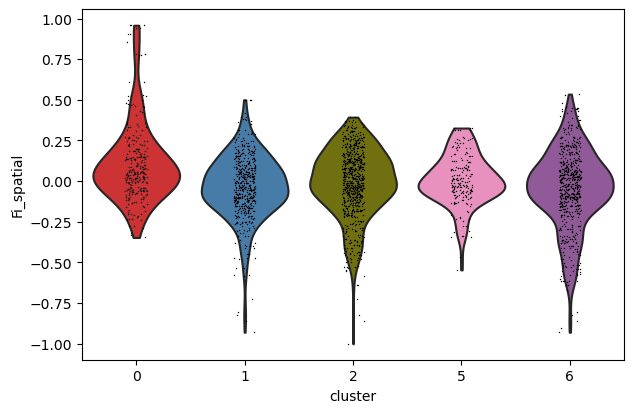

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


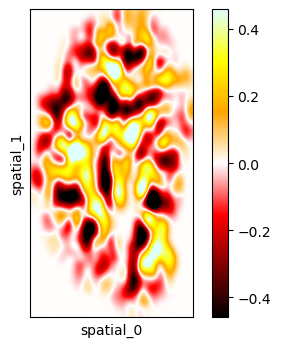

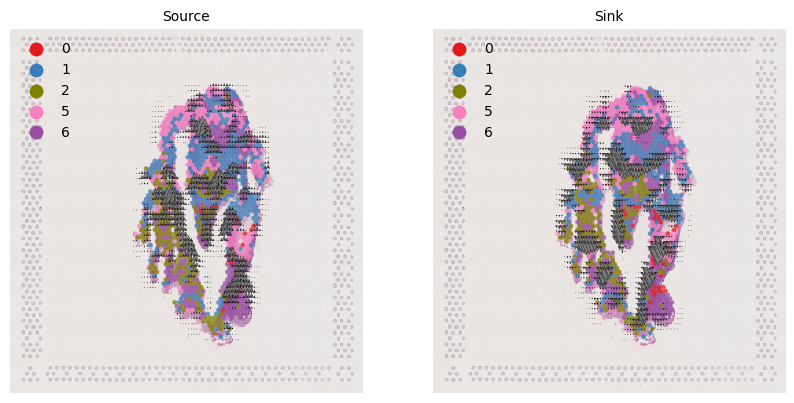

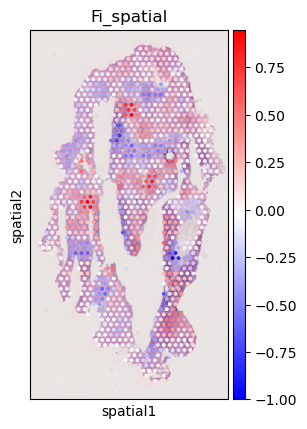

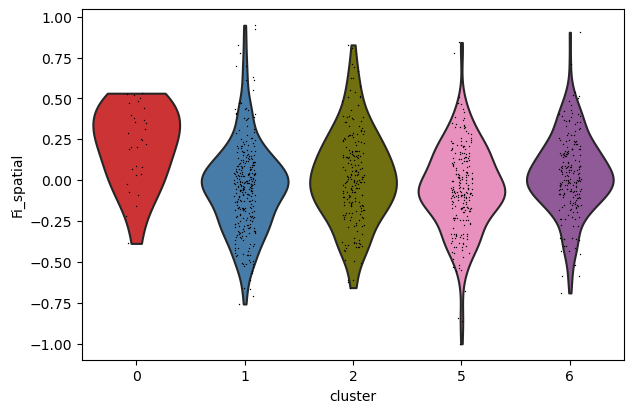

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


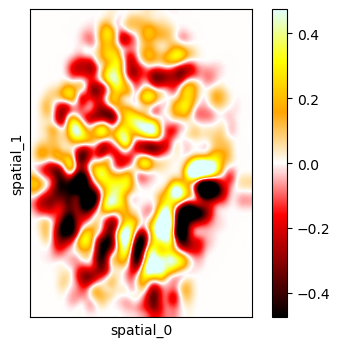

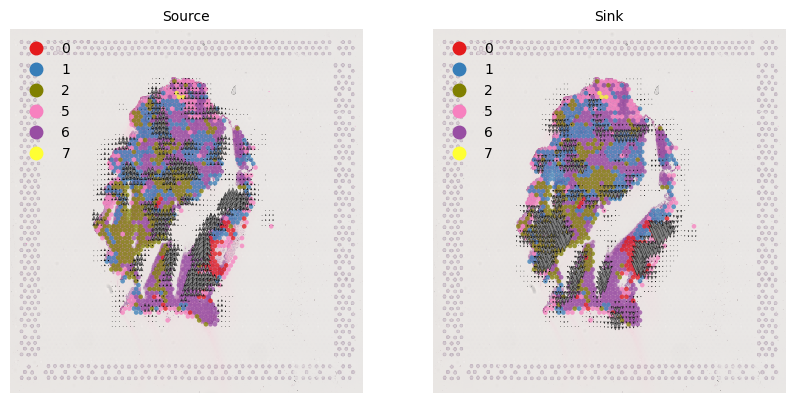

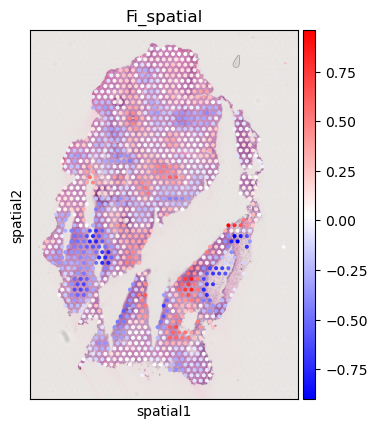

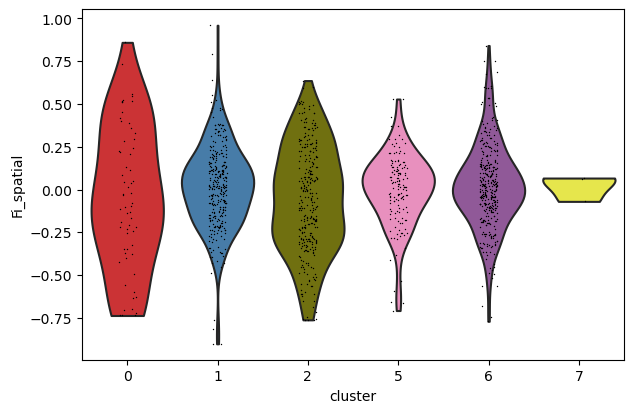

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


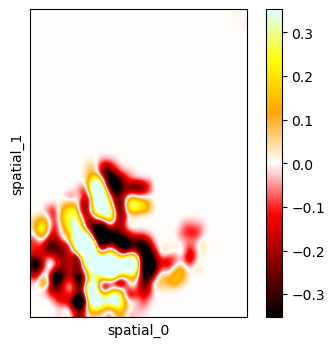

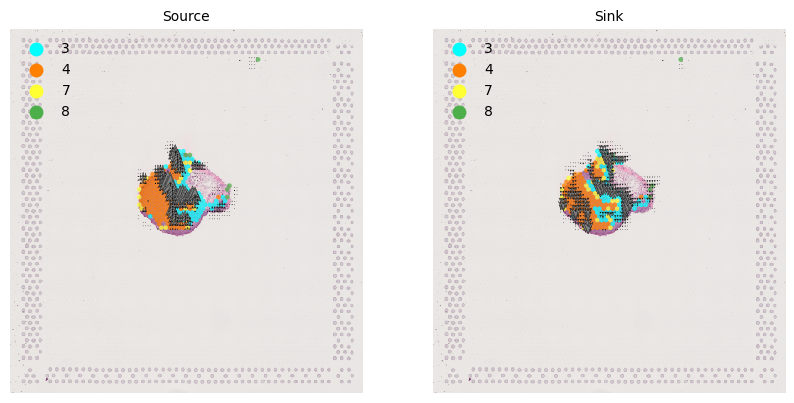

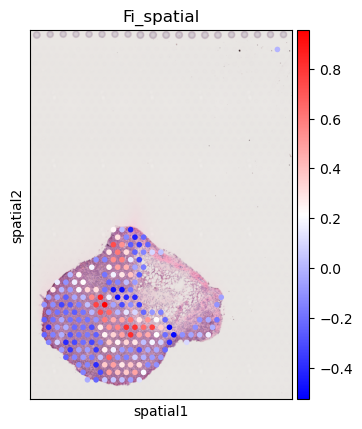

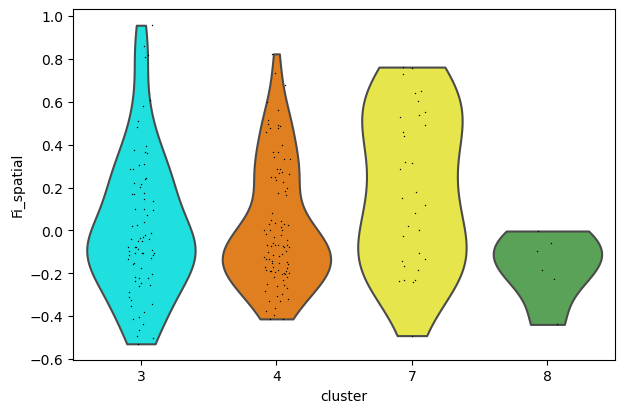

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


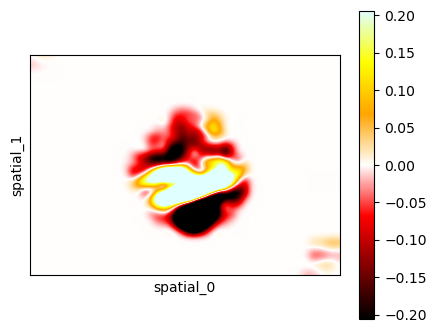

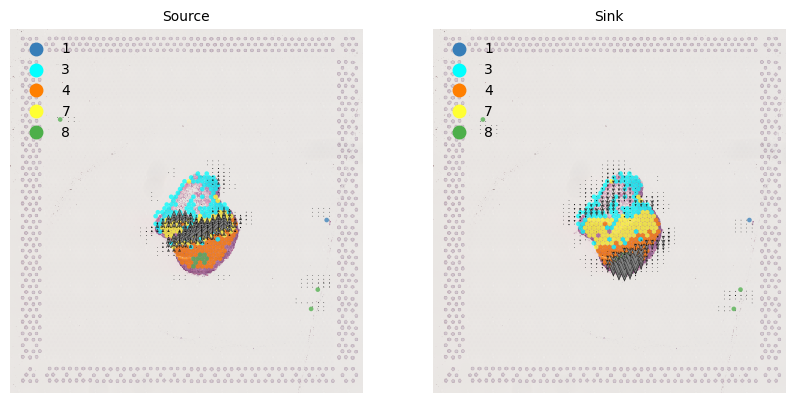

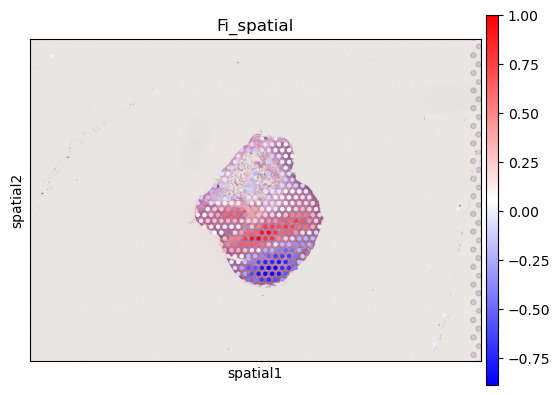

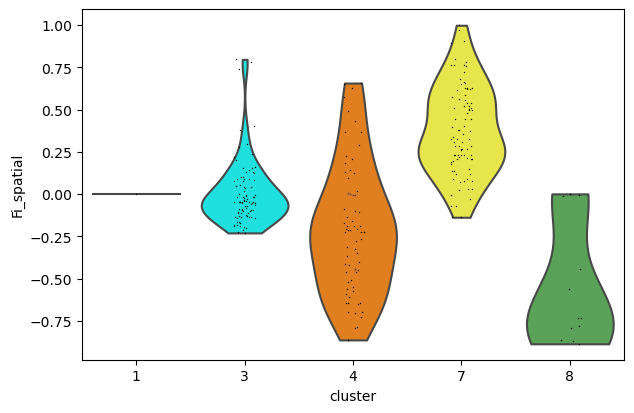

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


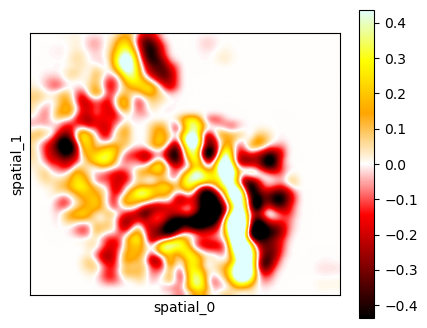

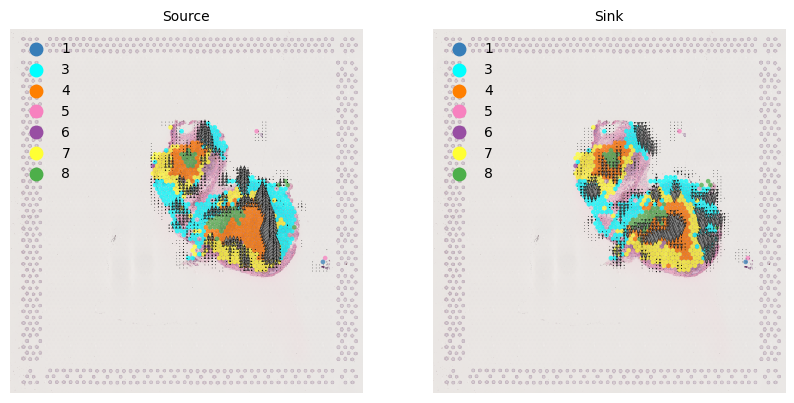

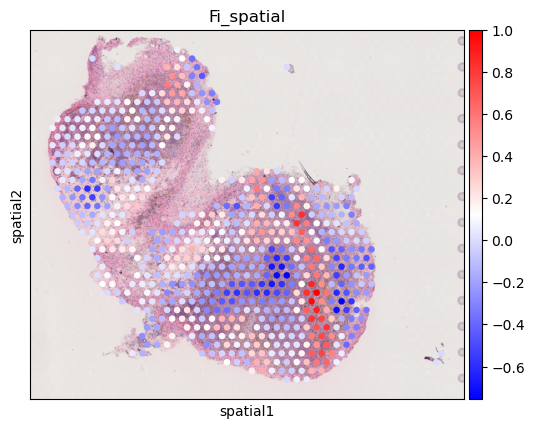

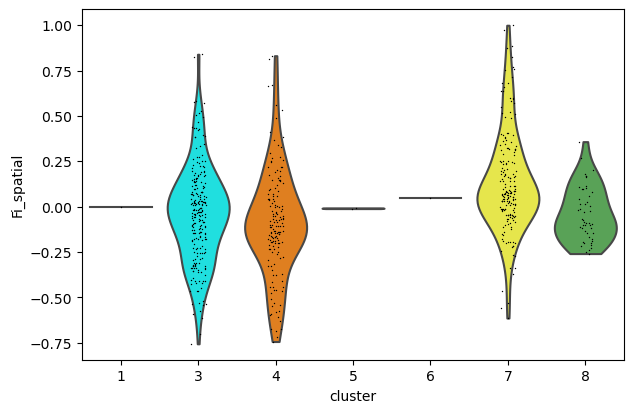

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


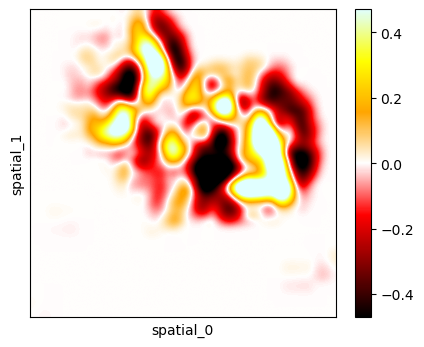

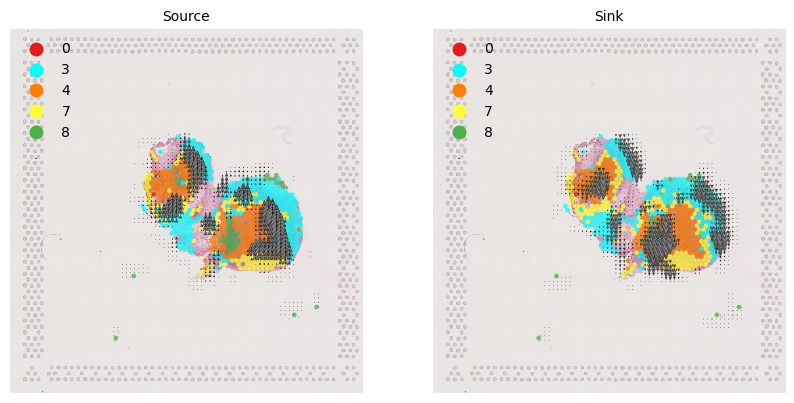

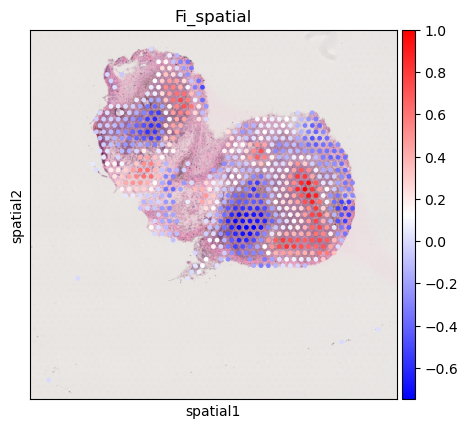

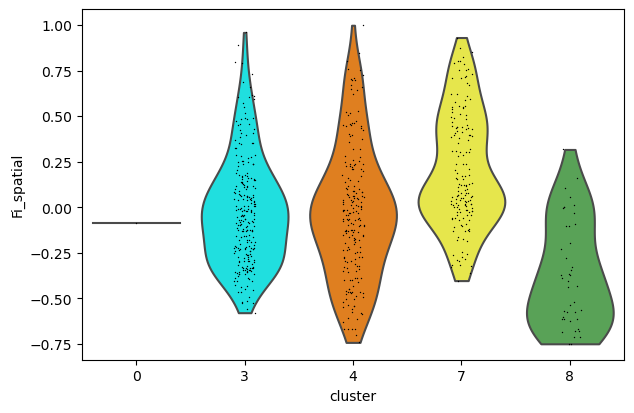

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


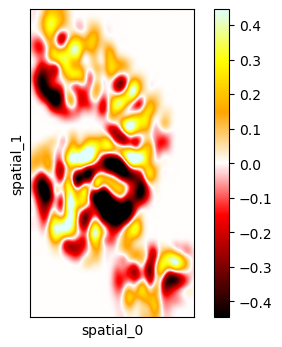

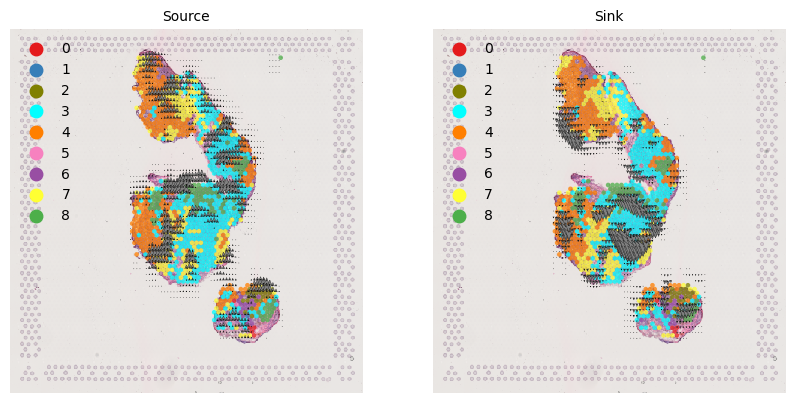

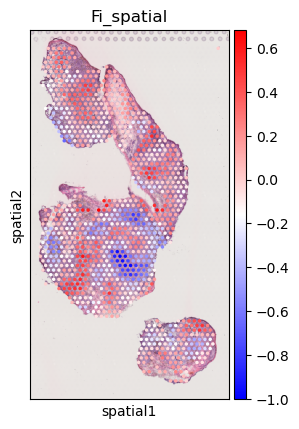

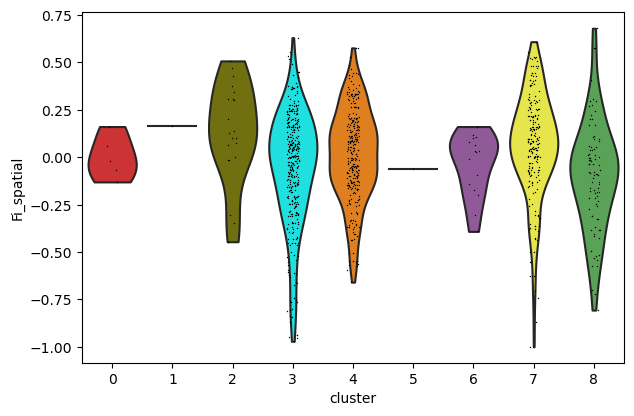

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


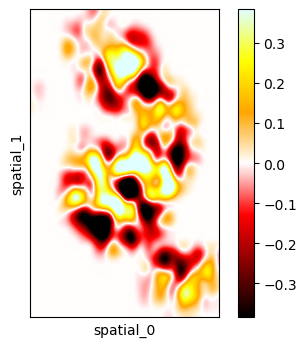

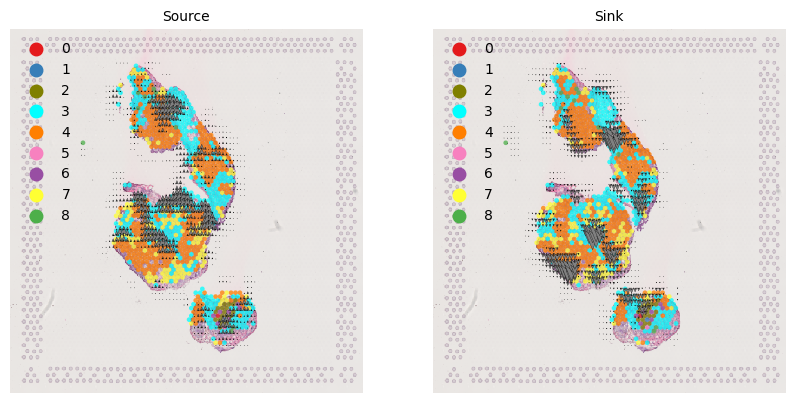

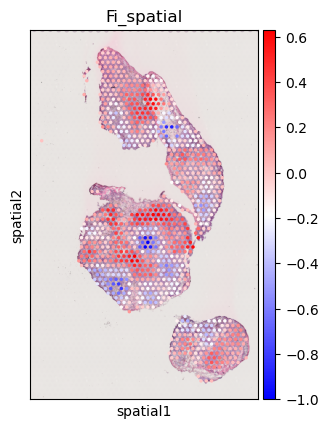

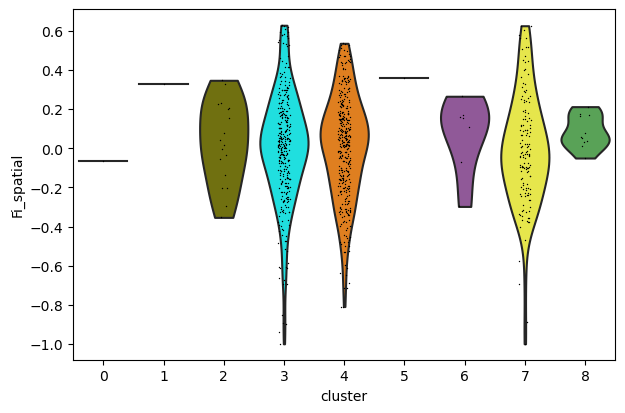

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


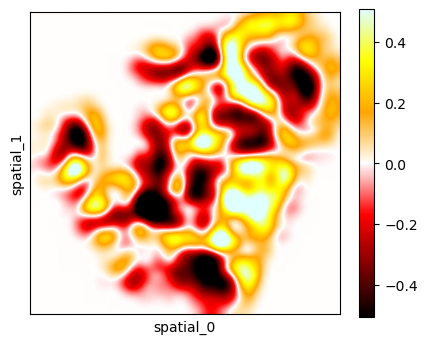

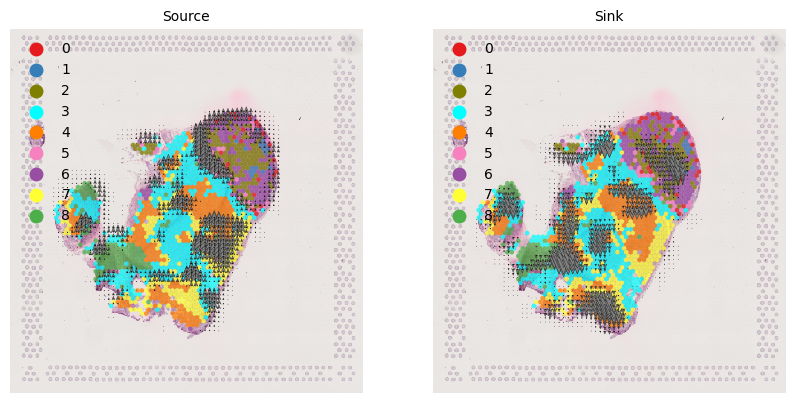

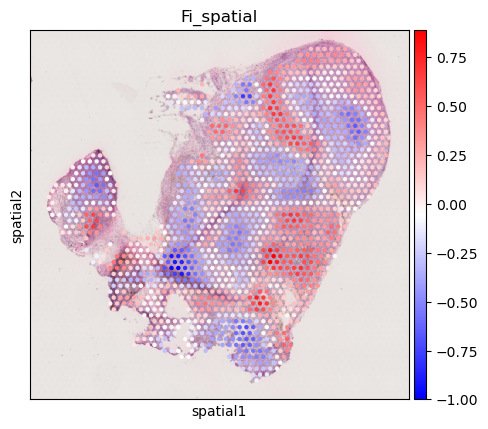

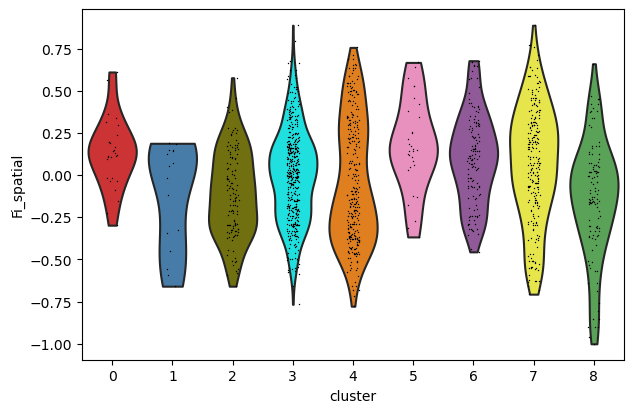

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


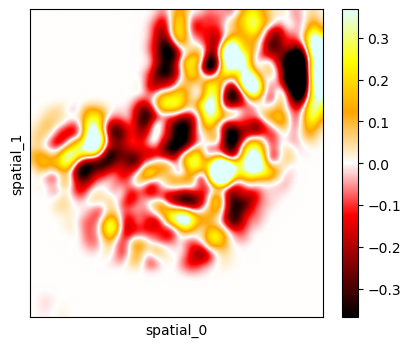

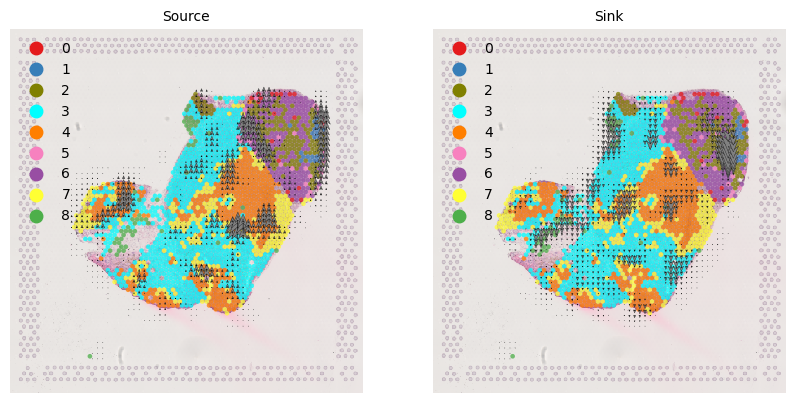

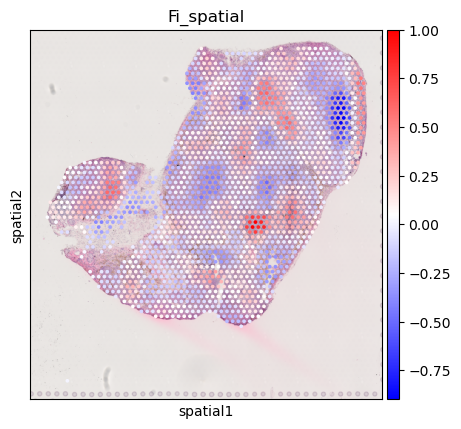

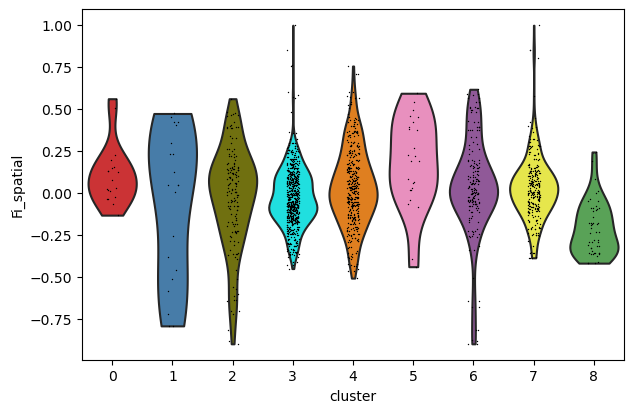

In [15]:
for id in ids:
    ad = ads[id]

    X_grid_full, V_grid_full, X_emb = computFullGridVelocity(ad, emb='spatial')
    gridPhi = getGridPhi(X_grid_full, V_grid_full, R=2)
    plotPhiHeatmap(gridPhi, X_grid_full, emb='spatial');

    if True:
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        
        params = dict(density=1, arrow_size=100, arrow_length=2000, color=identity, palette=palette_rna, size=45, alpha=0.75) 
        
        ax = axs[0]
        X_source, V_source = getGridVelocityForSourceSink(X_grid_full, V_grid_full, gridPhi, isSource=True)
        scv.pl.velocity_embedding_grid(ad, basis='X_spatial', X_grid=X_source, V_grid=V_source, legend_loc='none', title='Source', ax=axs[0], show=False, **params)
        
        (xmin, xmax), (ymin, ymax) = ax.get_xlim(), ax.get_ylim()
        sf = ads[sample].uns['spatial']['library_id']['scalefactors']['tissue_lowres_scalef']
        image = ad.uns['spatial']['library_id']['images']['lowres'].copy()
        ax.imshow(image, interpolation='none', extent=[0, image.shape[1]/sf, -20/sf-image.shape[1]/sf, 0], zorder=-1)
        ax.legend(frameon=False, loc='upper left', fontsize=10, markerscale=1.5)

        ax = axs[1]
        X_sink, V_sink = getGridVelocityForSourceSink(X_grid_full, V_grid_full, gridPhi, isSource=False)
        scv.pl.velocity_embedding_grid(ad, basis='X_spatial', X_grid=X_sink, V_grid=V_sink, legend_loc='none', title='Sink', ax=axs[1], show=False, **params)
        
        (xmin, xmax), (ymin, ymax) = ax.get_xlim(), ax.get_ylim()
        sf = ads[sample].uns['spatial']['library_id']['scalefactors']['tissue_lowres_scalef']
        image = ad.uns['spatial']['library_id']['images']['lowres'].copy()
        ax.imshow(image, interpolation='none', extent=[0, image.shape[1]/sf, -20/sf-image.shape[1]/sf, 0], zorder=-1)
        ax.legend(frameon=False, loc='upper left', fontsize=10, markerscale=1.5)

    Fi_emb = getFiOfEmb(X_grid_full, gridPhi, X_emb)
    ad.obs['Fi_spatial'] = Fi_emb
    sc.pl.spatial(ad, color='Fi_spatial', cmap='bwr')
    sc.pl.violin(ad, keys='Fi_spatial', groupby='cluster')

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
 

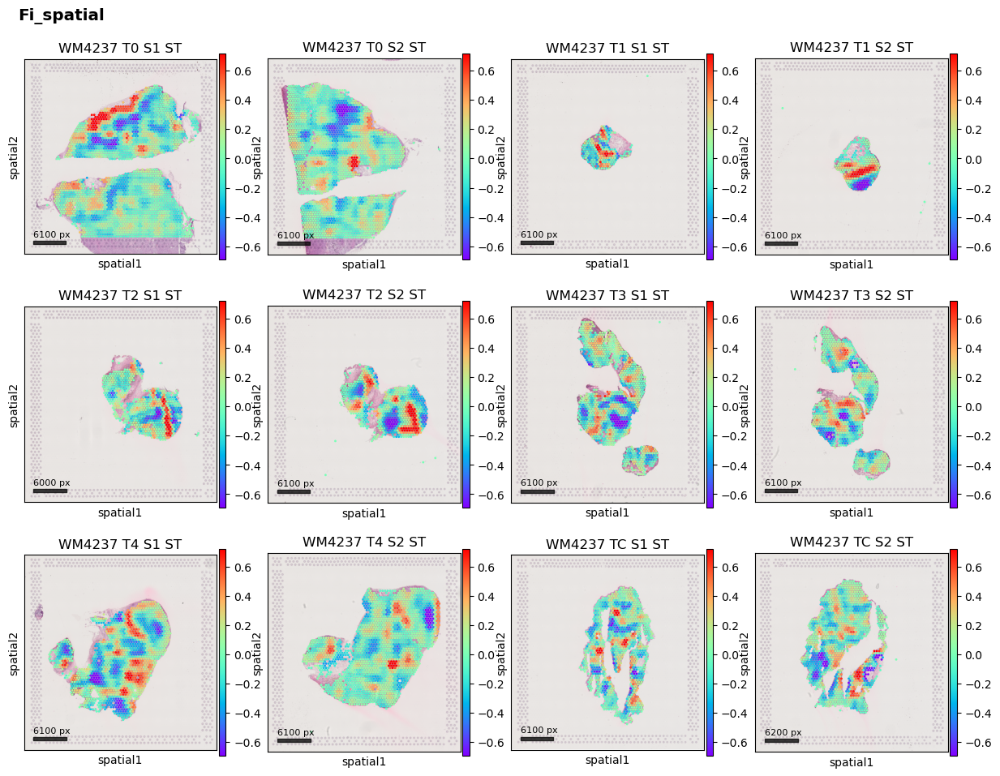

In [16]:
plotSpatialAll(ads, identity='Fi_spatial')

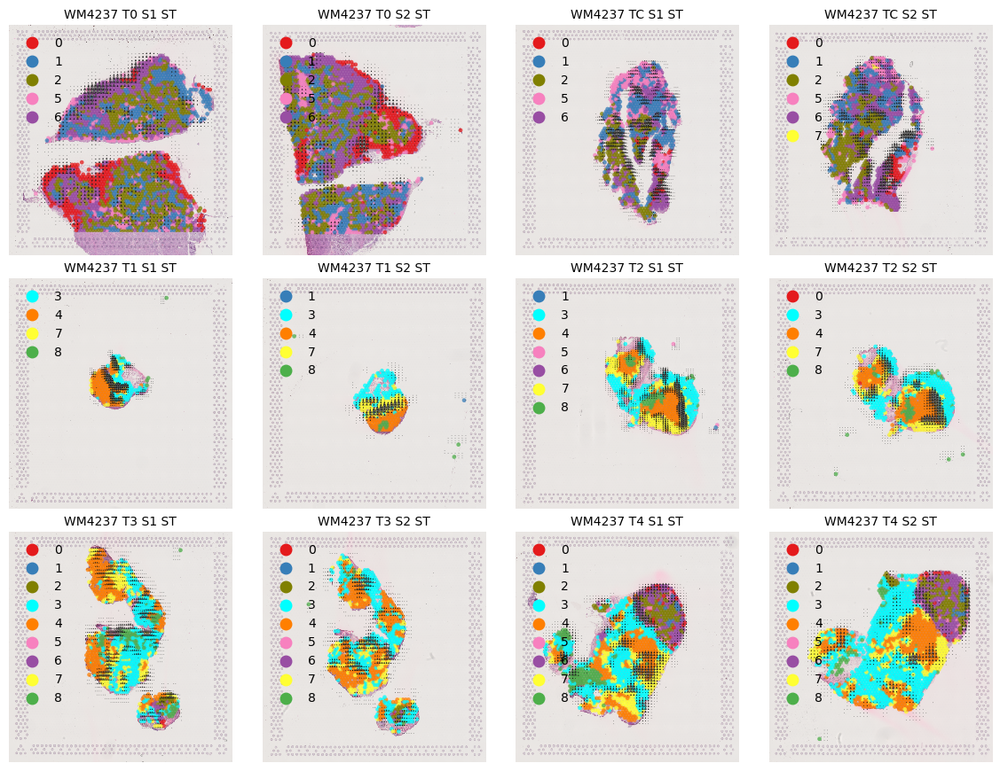

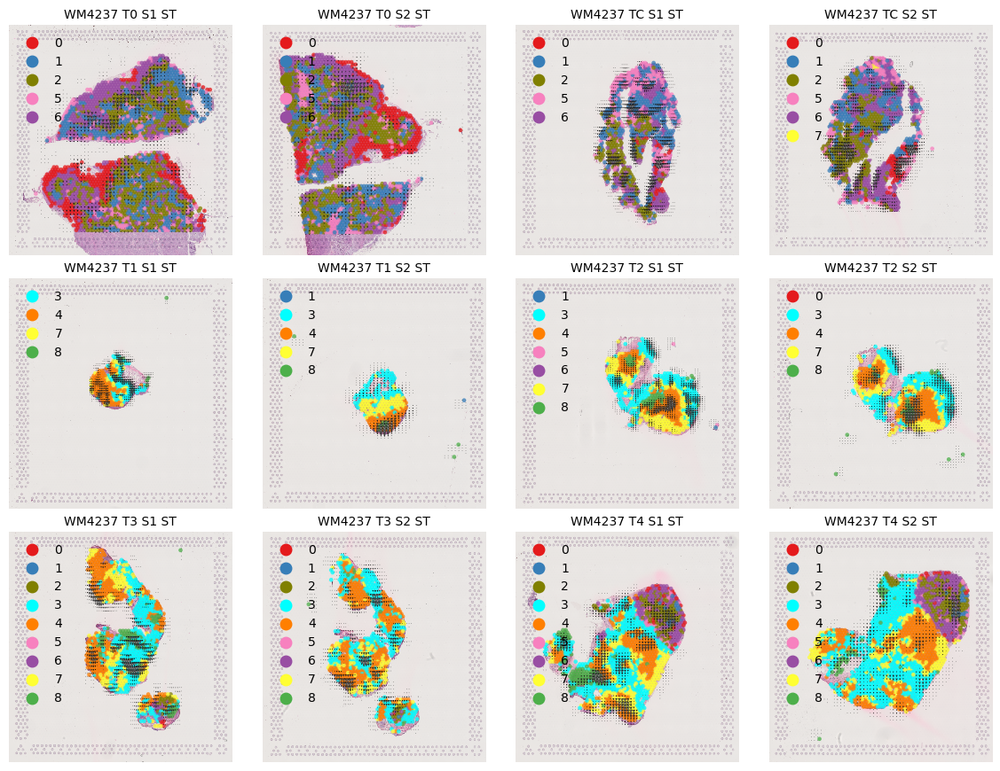

In [17]:
for isSource in [True, False]:
    f = 0.8
    ncols = 4
    nrows = 3
    fig, axs = plt.subplots(nrows, ncols, figsize=(f*4.5*ncols, f*4.5*nrows))
    for isample, sample in enumerate(ids):
        ax = axs[int((isample - isample%ncols)/nrows), isample%ncols]
        identity = 'cluster'
        ad = ads[sample]

        X_grid_full, V_grid_full, X_emb = computFullGridVelocity(ad, emb='spatial')
        gridPhi = getGridPhi(X_grid_full, V_grid_full, R=2)

        params = dict(density=1, arrow_size=100, arrow_length=1000, color=identity, palette=palette_rna, size=45, alpha=0.75) 

        X_source, V_source = getGridVelocityForSourceSink(X_grid_full, V_grid_full, gridPhi, isSource=isSource)
        scv.pl.velocity_embedding_grid(ad, basis='X_spatial', X_grid=X_source, V_grid=V_source, legend_loc='none', title=sample, ax=ax, show=False, **params)

        (xmin, xmax), (ymin, ymax) = ax.get_xlim(), ax.get_ylim()
        sf = ads[sample].uns['spatial']['library_id']['scalefactors']['tissue_lowres_scalef']
        image = ad.uns['spatial']['library_id']['images']['lowres'].copy()
        ax.imshow(image, interpolation='none', extent=[0, image.shape[1]/sf, -20/sf-image.shape[1]/sf, 0], zorder=-1)
        ax.legend(frameon=False, loc='upper left', fontsize=10, markerscale=1.5)

    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    suffix = 'source' if isSource else 'sink'
    plt.show()
    fig.savefig(f'{model} spatial rna velocity {suffix}.png', dpi=300)